# Schematic view of mechanism:

<img src="images/full_scheme.png" alt="Image" width="600" height="300">

In [1]:
from matplotlib.animation import FuncAnimation
from scipy.optimize import fsolve
from scipy.integrate import solve_ivp
from scipy.optimize import newton_krylov
import matplotlib.pyplot as plt
import numpy as np
import sympy as sm
import sympy.physics.mechanics as me
from IPython.display import HTML

sm.init_printing()

In [29]:
# Variable definititon

l_ol1, l_ol2, l_or1, l_or2, l_il, l_ir, rho = sm.symbols('l_ol1, l_ol2, l_or1, l_or2, l_il, l_ir, rho')

a, q1, q2 = me.dynamicsymbols('a, q1, q2')
u1, u2, ua = me.dynamicsymbols('u1, u2, ua')
Fx, Fy = me.dynamicsymbols('Fx, Fy')
Fa = me.dynamicsymbols('Fa')

# definition of other dependent angles
q3 = q2 - sm.pi

N = me.ReferenceFrame('N')
A = me.ReferenceFrame('A')
B = me.ReferenceFrame('B')
C = me.ReferenceFrame('C')
D = me.ReferenceFrame('D')

# Reference frames orientation
A.orient_axis(N, N.z, q1) # l_ir
B.orient_axis(A, A.z, q2) # l_or1, l_or2
C.orient_axis(A, A.z, q2 - sm.pi) # l_il
D.orient_axis(C, C.z, -(q2 - sm.pi)) # l_ol

# Masses definition
m_A = rho * (l_ir)
m_B = rho * (l_or1 + l_or2)
m_C = rho * (l_il)
m_D = rho * (l_ol1 + l_ol2)

m_blade = 0.65
m_mover = 1.13 +0.4 #+ 0.81
m_base = 7.5

# Point definition - joints and centers of mass
O, P1, P2, P3, P4, P5 = sm.symbols('O, P1, P2, P3, P4, P5', cls = me.Point)
Ao, Bo, Co, Do = sm.symbols('Ao, Bo, Co, Do', cls = me.Point)

# Point position definition - ref scheme in Figure 1
P1.set_pos(P2, l_or1 * B.x)
P2.set_pos(O, l_ir * A.x)
P3.set_pos(P2, - l_or2 * B.x)
P4.set_pos(P3, - l_ol2 * A.x)
P5.set_pos(P4, - l_ol1 * A.x)

# Center of mass position definition
Ao.set_pos(O, l_ir/2 * A.x)
Bo.set_pos(P1, -0.5*(l_or1+l_or2) * A.x)
Co.set_pos(O, l_il/2 * C.x)
Do.set_pos(P5, 0.5*(l_ol1+l_ol2)*D.x)

# Moment of inertia of links
I_A_Ao = me.inertia(A, ixx=0, iyy=0, izz= m_A * l_ir**2 /12)
I_B_Bo = me.inertia(B, ixx=0, iyy=0, izz= m_B * (l_or1+l_or2)**2 /12)
I_C_Co = me.inertia(C, ixx=0, iyy=0, izz= m_C * l_il**2 /12)
I_D_Do = me.inertia(D, ixx=0, iyy=0, izz= m_D * (l_ol1+l_ol2)**2 /12)

# CoM position
R_CM_O = (Ao.pos_from(O)*m_A +Bo.pos_from(O)*m_B+Co.pos_from(O)*m_C+Do.pos_from(O)*m_D+P1.pos_from(O)*(m_mover+m_blade)+P5.pos_from(O)*(m_base))/(m_A+m_B+m_C+m_D+m_mover+m_blade+m_base)


In [3]:
t = me.dynamicsymbols._t

q = sm.Matrix([a, q1, q2])
u = sm.Matrix([ua, u1, u2])

qd = q.diff(t)
ud = u.diff(t)

u_def = u - qd

# Holonomic constraint definition
fh_v = l_ir * A.x + l_or1 * B.x - a * N.x
fh = sm.Matrix([fh_v.dot(N.x), fh_v.dot(N.y)]) # Projection of vector loop
fhd = fh.diff(t)

# Replacement vector for gen speeds
qd_repl = sm.solve(u_def, qd)

# Replacement vector for dependent speeds
us = sm.Matrix([ua])
ur = sm.Matrix([u1, u2])

u_repl = sm.solve(fhd.xreplace(qd_repl), ur)

/Users/riccardodigirolamo/opt/anaconda3/lib/python3.9/site-packages/sympy/physics/vector/point.py:570: UserWarning: Velocity automatically calculated based on point O but it is also possible from points(s):[Bo]. Velocities from these points are not necessarily the same. This may cause errors in your calculations.
  warn('Velocity automatically calculated based on point ' +
/Users/riccardodigirolamo/opt/anaconda3/lib/python3.9/site-packages/sympy/physics/vector/point.py:570: UserWarning: Velocity automatically calculated based on point Bo but it is also possible from points(s):[O, Do]. Velocities from these points are not necessarily the same. This may cause errors in your calculations.
  warn('Velocity automatically calculated based on point ' +
/Users/riccardodigirolamo/opt/anaconda3/lib/python3.9/site-packages/sympy/physics/vector/point.py:570: UserWarning: Velocity automatically calculated based on point Do but it is also possible from points(s):[P1, O]. Velocities from these points

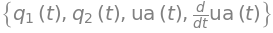

In [4]:
# Definitoon of auxiliary generalized speeds
u3, u4 = me.dynamicsymbols('u3, u4')
u_aux = sm.Matrix([u3, u4])
u_aux_zero = {ux: 0 for ux in u_aux}

# Auxiliary velocity of O
O.set_vel(N, u3*N.x+ u4*N.y)
#O.set_vel(N, 0)


# Velocities of centers of mass
N_v_Ao = Ao.vel(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)
N_v_Bo = Bo.vel(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)
N_v_Co = Co.vel(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)
N_v_Do = Do.vel(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)
N_v_P1 = P1.vel(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)
N_v_P5 = P5.vel(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)

N_w_A = A.ang_vel_in(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)
N_w_B = B.ang_vel_in(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)
N_w_C = C.ang_vel_in(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)
N_w_D = D.ang_vel_in(N).xreplace(qd_repl).xreplace(u_repl).xreplace(u_aux_zero)

vels = (N_w_A, N_w_B, N_w_C, N_w_D, N_v_Ao, N_v_Bo, N_v_Co, N_v_Do, N_v_P1, N_v_P5)

# Compute partial velocities
w_A, w_B, w_C, w_D, v_Ao, v_Bo, v_Co, v_Do, v_P1, v_P5 = me.partial_velocity(vels, us, N)


# Compute accelerations
N_a_Ao = N_v_Ao.diff(t, N).xreplace(qd_repl).xreplace(u_repl)
N_a_Bo = N_v_Bo.diff(t, N).xreplace(qd_repl).xreplace(u_repl)
N_a_Co = N_v_Co.diff(t, N).xreplace(qd_repl).xreplace(u_repl)
N_a_Do = N_v_Do.diff(t, N).xreplace(qd_repl).xreplace(u_repl)
N_a_P1 = N_v_P1.diff(t, N).xreplace(qd_repl).xreplace(u_repl)
N_a_P5 = N_v_P5.diff(t, N).xreplace(qd_repl).xreplace(u_repl)

N_a_A = N_w_A.diff(t, N).xreplace(qd_repl).xreplace(u_repl)
N_a_B = N_w_B.diff(t, N).xreplace(qd_repl).xreplace(u_repl)
N_a_C = N_w_C.diff(t, N).xreplace(qd_repl).xreplace(u_repl)
N_a_D = N_w_D.diff(t, N).xreplace(qd_repl).xreplace(u_repl)

me.find_dynamicsymbols(N_a_Ao.to_matrix(N))

In [5]:
# Exposing noncontributing forces - definitions

# Velocities of centers of mass - AUXILIARY
N_v_Oa  = O.vel(N).xreplace(qd_repl).xreplace(u_repl)
N_v_Aoa = Ao.vel(N).xreplace(qd_repl).xreplace(u_repl)
N_v_Boa = Bo.vel(N).xreplace(qd_repl).xreplace(u_repl)
N_v_Coa = Co.vel(N).xreplace(qd_repl).xreplace(u_repl)
N_v_Doa = Do.vel(N).xreplace(qd_repl).xreplace(u_repl)
N_v_P1a = P1.vel(N).xreplace(qd_repl).xreplace(u_repl)
N_v_P5a = P5.vel(N).xreplace(qd_repl).xreplace(u_repl)

N_w_Aa = A.ang_vel_in(N).xreplace(qd_repl).xreplace(u_repl)
N_w_Ba = B.ang_vel_in(N).xreplace(qd_repl).xreplace(u_repl)
N_w_Ca = C.ang_vel_in(N).xreplace(qd_repl).xreplace(u_repl)
N_w_Da = D.ang_vel_in(N).xreplace(qd_repl).xreplace(u_repl)

vels_a = (N_w_Aa, N_w_Ba, N_w_Ca, N_w_Da, N_v_Oa, N_v_Aoa, N_v_Boa, N_v_Coa, N_v_Doa, N_v_P1a, N_v_P5a)

# Compute partial velocities - AUXILIARY
w_Aa, w_Ba, w_Ca, w_Da, v_Oa, v_Aoa, v_Boa, v_Coa, v_Doa, v_P1a, v_P5a = me.partial_velocity(vels_a, [u3, u4], N)


me.find_dynamicsymbols(N_v_Aoa.to_matrix(N))

In [6]:
# Inertia forces definition
Rs_Ao = - m_A * N_a_Ao
Rs_Bo = - m_B * N_a_Bo
Rs_Co = - m_C * N_a_Co
Rs_Do = - m_D * N_a_Do
Rs_P1 = - (m_blade + m_mover) * N_a_P1
Rs_P5 = - (m_base) * N_a_P5

Ts_A = - (I_A_Ao.dot(N_a_A) + me.cross(N_w_A, I_A_Ao).dot(N_w_A))
Ts_B = - (I_B_Bo.dot(N_a_B) + me.cross(N_w_B, I_B_Bo).dot(N_w_B))
Ts_C = - (I_C_Co.dot(N_a_C) + me.cross(N_w_C, I_C_Co).dot(N_w_C))
Ts_D = - (I_D_Do.dot(N_a_D) + me.cross(N_w_D, I_D_Do).dot(N_w_D))

# Generalized Inertia forces
F1s_A = v_Ao[0].dot(Rs_Ao) + w_A[0].dot(Ts_A)
F1s_B = v_Bo[0].dot(Rs_Bo) + w_B[0].dot(Ts_B)
F1s_C = v_Co[0].dot(Rs_Co) + w_C[0].dot(Ts_C)
F1s_D = v_Do[0].dot(Rs_Do) + w_D[0].dot(Ts_D)
F1s_P1 = v_P1[0].dot(Rs_P1) 
F1s_P5 = v_P5[0].dot(Rs_P5) 

F1s = F1s_A + F1s_B + F1s_C + F1s_D  + F1s_P1 + F1s_P5


# Generalized Inertia forces - AUXILIARY
F2s_A = v_Aoa[0].dot(Rs_Ao) + w_Aa[0].dot(Ts_A)
F2s_B = v_Boa[0].dot(Rs_Bo) + w_Ba[0].dot(Ts_B)
F2s_C = v_Coa[0].dot(Rs_Co) + w_Ca[0].dot(Ts_C)
F2s_D = v_Doa[0].dot(Rs_Do) + w_Da[0].dot(Ts_D)
F2s_P1 = v_P1a[0].dot(Rs_P1) 
F2s_P5 = v_P5a[0].dot(Rs_P5)

F2s = F2s_A + F2s_B + F2s_C + F2s_D + F2s_P1 + F2s_P5

F3s_A = v_Aoa[1].dot(Rs_Ao) + w_Aa[1].dot(Ts_A)
F3s_B = v_Boa[1].dot(Rs_Bo) + w_Ba[1].dot(Ts_B)
F3s_C = v_Coa[1].dot(Rs_Co) + w_Ca[1].dot(Ts_C)
F3s_D = v_Doa[1].dot(Rs_Do) + w_Da[1].dot(Ts_D)
F3s_P1 = v_P1a[1].dot(Rs_P1) 
F3s_P5 = v_P5a[1].dot(Rs_P5)

F3s = F3s_A + F3s_B + F3s_C + F3s_D + F3s_P1 + F3s_P5

Frs = sm.Matrix([F1s, F2s, F3s])

# Active forces
F = sm.Matrix([Fa])
R_P1 = Fa * N.x
R_P5 = -Fa * N.x

F1_P1 = v_P1[0].dot(R_P1)
F1_P5 = v_P5[0].dot(R_P5)

F1 = F1_P1 + F1_P5


# Spring forces still to be added 

# Active Forces - AUXILIARY
R_O_a = -Fx * N.x - Fy * N.y
F3 = v_Oa[0].dot(R_O_a) + v_P1a[0].dot(R_P1) + v_P5a[0].dot(R_P5)
F4 = v_Oa[1].dot(R_O_a) + v_P1a[1].dot(R_P1) + v_P5a[1].dot(R_P5)

Fr = sm.Matrix([F1, F3, F4])


me.find_dynamicsymbols(v_Ao[0].dot(Rs_Ao))

me.find_dynamicsymbols(F3)

In [7]:
usd = us.diff(t)
usd_zero = {usdz:0 for usdz in usd}
qd_zero = {qdz:0 for qdz in qd}

Md = Frs[0].diff(usd)
gd = Frs[0].xreplace(usd_zero) + Fr[0]

Mk = u_def.jacobian(qd)
gk = u.xreplace(u_repl)

In [8]:
me.find_dynamicsymbols(gd)

In [9]:
# Noncontributing forces - EXTRACTING EXPRESSIONS

udr = sm.Matrix([ua.diff(t), Fx, Fy])
udr_zero = {udrz: 0 for udrz in udr}

fa = Frs + Fr

Ma = fa.jacobian(udr)
ga = fa.xreplace(udr_zero)

udr_sol = -Ma.LUsolve(ga)

F3_sol = udr_sol[1]
F4_sol = udr_sol[2]

me.find_dynamicsymbols(ga)

In [10]:
p = sm.Matrix([l_ol1, l_ol2, l_or1, l_or2, l_il, l_ir, rho])

eval_k = sm.lambdify((q, us, p, F), (Mk, gk))
eval_d = sm.lambdify((q, us, p, F), (Md, gd))
eval_fh = sm.lambdify((q, p), fh)

In [11]:
me.find_dynamicsymbols(Mk), me.find_dynamicsymbols(gk), me.find_dynamicsymbols(Md), me.find_dynamicsymbols(gd)

In [31]:
# Acceleration profile definition
def step(A, t0, t):
    if t > t0:
        return A
    else: return 0

    
def acc_profile(t):
    profile = (step(400, 0.1, t) + step(-400, 0.1+0.0025, t)+
               step(-400, 0.2-0.0025, t) + step(400, 0.2, t)+
               step(-400, 0.2, t) + step(400, 0.2+0.0025, t)+
               step(400, 0.3-0.0025, t) + step(-400, 0.3, t))
               
    return profile



# Velocity profile definition
def ramp(m, t0, t):
    if t >= t0:
        return m*(t-t0)
    else: return 0

def profile_v_front(t):
    return (ramp(400, 0.1, t) + ramp(-400, 0.1+0.0025, t) + ramp(-400, 0.2-0.0025, t) + ramp(400, 0.2, t))

def profile_v_back(t):
    return (ramp(-400, 0.2, t) + ramp(400, 0.2+0.0025, t) + ramp(400, 0.3-0.0025, t) + ramp(-400, 0.3, t))
    
    
time = np.linspace(0, 0.5, 1000)
val_v = []


for ts in time:
    val_v.append(profile_v_front(ts) + profile_v_back(ts) )
    
#plt.plot(time, val_v)



40000it [00:00, 163995.67it/s]


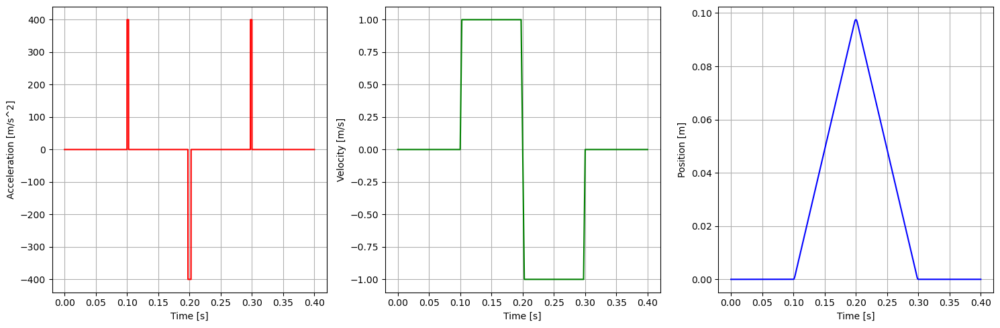

In [33]:
from tqdm import tqdm

# Profile integration
tspan = [0, 0.4]
delt = 0.00001

# generate monotonically increasing values of time.
duration = tspan[1] - tspan[0]
num_samples = round(duration/delt) + 1
ts = np.arange(tspan[0], tspan[0] + delt*num_samples, delt)

# create an empty array to hold the state values.
v = np.empty(len(ts))
pos = np.empty(len(ts))
acc = np.empty(len(ts))

# set the initial conditions to the first element.
acc[0] = 0
v[0] = 0
pos[0] = 0

# use a for loop to sequentially calculate each new x.
for i, ti in tqdm(enumerate(ts[:-1])):
    acc[i] = acc_profile(ti)
    v[i + 1] = v[i] + delt*acc_profile(ti)
    pos[i + 1] = pos[i] + delt*v[i]
        
# Create a figure with subplots
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Plot acceleration
axs[0].plot(ts, acc, color='red')
axs[0].set_xlabel('Time [s]')
axs[0].set_ylabel('Acceleration [m/s^2]')
axs[0].grid(True)

# Plot velocity
axs[1].plot(ts, v, color='green')
axs[1].set_xlabel('Time [s]')
axs[1].set_ylabel('Velocity [m/s]')
axs[1].grid(True)

# Plot position
axs[2].plot(ts, pos, color='blue')
axs[2].set_xlabel('Time [s]')
axs[2].set_ylabel('Position [m]')
axs[2].grid(True)

# Adjust subplot spacing
plt.tight_layout()

# Show the figure
plt.show()

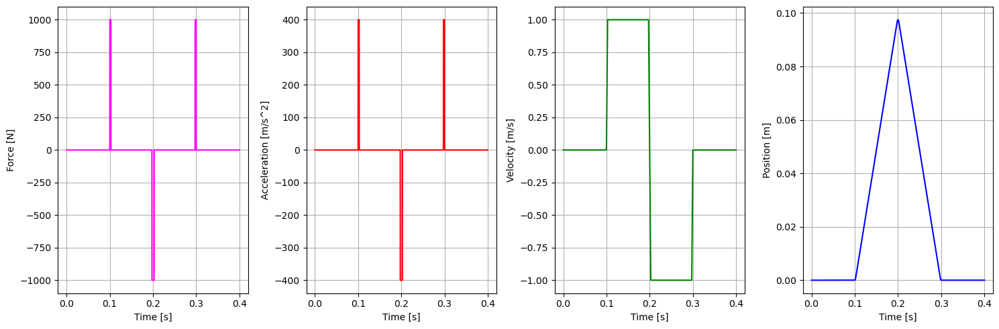

In [49]:
# Force profile definition

def step(A, t0, t):
    if t > t0:
        return A
    else: return 0

    
def force_profile(t):
    profile = (step(1000, 0.1, t) + step(-1000, 0.1+0.0025, t)+
               step(-1000, 0.2-0.0025, t) + step(1000, 0.2, t)+
               step(-1000, 0.2, t) + step(1000, 0.2+0.0025, t)+
               step(1000, 0.3-0.0025, t) + step(-1000, 0.3, t))
               
    return profile
               
forc = []               
for t in ts:
    forc.append(force_profile(t))
    
# Create a figure with subplots
fig, axs = plt.subplots(1, 4, figsize=(15, 5))

# Plot acceleration
axs[0].plot(ts, forc, color='magenta')
axs[0].set_xlabel('Time [s]')
axs[0].set_ylabel('Force [N]')
axs[0].grid(True)

# Plot acceleration
axs[1].plot(ts, acc, color='red')
axs[1].set_xlabel('Time [s]')
axs[1].set_ylabel('Acceleration [m/s^2]')
axs[1].grid(True)

# Plot velocity
axs[2].plot(ts, v, color='green')
axs[2].set_xlabel('Time [s]')
axs[2].set_ylabel('Velocity [m/s]')
axs[2].grid(True)

# Plot position
axs[3].plot(ts, pos, color='blue')
axs[3].set_xlabel('Time [s]')
axs[3].set_ylabel('Position [m]')
axs[3].grid(True)

# Adjust subplot spacing
plt.tight_layout()

# Show the figure
plt.show()


In [35]:
def simulate(eval_rhs, t0, tf, fps, x0, p):
    """Returns the simulation results.

    Parameters
    ==========
    eval_rhs : function
       Function that returns the derivatives of the states in the form:
       ``eval_rhs(t, x, p)``.
    t0 : float
       Initial time in seconds.
    tf : float
       Final time in seconds.
    fps : integer
       Number of "frames" per second to output.
    q1_0 : float
       Initial q1 angle in radians.
    u1_0 : float
       Initial u1 rate in radians/s.
    q2_0g : float
       Guess for the initial q2 angle in radians.
    q3_0g : float
       Guess for the initial q3 angle in radians.
    p : array_like, shape(6,)
       Constant parameters p = [la, lb, lc, ln, m, g].

    Returns
    =======
    ts : ndarray, shape(n,)
       Time values.
    xs : ndarray, shape(n, 4)
       State values at each time.
    con : ndarray, shape(n, 2)
       Constraint violations at each time in meters.

    """

    # generate the time steps
    ts = np.linspace(t0, tf, num=int(fps*(tf - t0)))


    # integrate the equations of motion
    #sol = solve_ivp(eval_rhs, (ts[0], ts[-1]), x0, args=(p,), t_eval=ts,
    #                rtol=1e-9, atol=1e-10)
    
    # integrate the equations of motion - euler forward
    ts, xs = rk45_integrate(eval_rhs, [t0, tf], x0, p, delt=0.0001)
    #ts, xs = euler_integrate(eval_rhs, [t0, tf], x0, p, delt=0.0001)
    
    #xs = np.transpose(sol.y)
    #ts = sol.t


    return ts, xs

In [36]:
from tqdm import tqdm

def euler_integrate(rhs_func, tspan, x0_vals, p_vals, delt=0.0001):
    """Returns state trajectory and corresponding values of time resulting
    from integrating the ordinary differential equations with Euler's
    Method.

    Parameters
    ==========
    rhs_func : function
       Python function that evaluates the derivative of the state and takes
       this form ``dxdt = f(t, x, p)``.
    tspan : 2-tuple of floats
       The initial time and final time values: (t0, tf).
    x0_vals : array_like, shape(2*n,)
       Values of the state x at t0.
    p_vals : array_like, shape(o,)
       Values of constant parameters.
    delt : float
       Integration time step in seconds/step.

    Returns
    =======
    ts : ndarray(m, )
       Monotonically increasing values of time.
    xs : ndarray(m, 2*n)
       State values at each time in ts.

    """
    # generate monotonically increasing values of time.
    duration = tspan[1] - tspan[0]
    num_samples = round(duration/delt) + 1
    ts = np.arange(tspan[0], tspan[0] + delt*num_samples, delt)

    # create an empty array to hold the state values.
    x = np.empty((len(ts), len(x0_vals)))

    # set the initial conditions to the first element.
    x[0, :] = x0_vals

    # use a for loop to sequentially calculate each new x.
    for i, ti in tqdm(enumerate(ts[:-1])):
        x[i + 1, :] = x[i, :] + delt*rhs_func(ti, x[i, :], p_vals)

    return ts, x

In [37]:
def rk45_integrate(rhs_func, tspan, x0_vals, p_vals, delt=0.0001):
    """Returns state trajectory and corresponding values of time resulting
    from integrating the ordinary differential equations with the Runge-Kutta
    4th/5th order method (RK45).

    Parameters
    ==========
    rhs_func : function
       Python function that evaluates the derivative of the state and takes
       this form ``dxdt = f(t, x, p)``.
    tspan : 2-tuple of floats
       The initial time and final time values: (t0, tf).
    x0_vals : array_like, shape(2*n,)
       Values of the state x at t0.
    p_vals : array_like, shape(o,)
       Values of constant parameters.
    delt : float
       Integration time step in seconds/step.

    Returns
    =======
    ts : ndarray(m, )
       Monotonically increasing values of time.
    xs : ndarray(m, 2*n)
       State values at each time in ts.

    """
    # generate monotonically increasing values of time.
    duration = tspan[1] - tspan[0]
    num_samples = round(duration / delt) + 1
    ts = np.arange(tspan[0], tspan[0] + delt * num_samples, delt)

    # create an empty array to hold the state values.
    x = np.empty((len(ts), len(x0_vals)))

    # set the initial conditions to the first element.
    x[0, :] = x0_vals

    # use a for loop to sequentially calculate each new x.
    for i, ti in tqdm(enumerate(ts[:-1])):
        k1 = rhs_func(ti, x[i, :], p_vals)
        k2 = rhs_func(ti + delt/2, x[i, :] + (delt/2) * k1, p_vals)
        k3 = rhs_func(ti + delt/2, x[i, :] + (delt/2) * k2, p_vals)
        k4 = rhs_func(ti + delt, x[i, :] + delt * k3, p_vals)
        k5 = rhs_func(ti + delt, x[i, :] + delt * (k1 + 2*k2 + 2*k3 + k4) / 6, p_vals)
        x[i + 1, :] = x[i, :] + delt * (k1 + 4*k3 + k4) / 6

    return ts, x

In [38]:
def eval_rhs_fsolve(t, x, p):
    """Return the derivative of the state at time t.

    Parameters
    ==========
    t : float
    x : array_like, shape(4,)
       x = [a, q1, q2, ua]
    p : array_like, shape(7,)
       p = [l_ol1, l_ol2, l_or1, l_or2, l_il, l_ir, rho]

    Returns
    =======
    xd : ndarray, shape(4,)
       xd = [ad, q1d, q2d, uad]

    Notes
    =====

    Includes a holonomic constraint correction.

    """
    q = x[:3]
    u = x[3:]
    
    force = np.array([force_profile(t)])
    #force = np.array([800])
    #u = [profile_v_front(t) + profile_v_back(t)]
    
    def fh_y(y):
        return eval_fh([q[0], y[0], y[1]], p).squeeze()

    # correct the dependent coordinates
    q[1:] = fsolve(fh_y, q[1:])
    #q[1:] = newton_krylov(fh_y, q[1:])
    Mk, gk = eval_k(q, u, p, force)
    qd = -np.linalg.solve(Mk, np.squeeze(gk))

    Md, gd = eval_d(q, u, p, force)
    ud = (-gd/Md)[0][0]
    

    return np.hstack((qd, ud))

In [40]:
# Parameters values definition
# p = [l_ol1, l_ol2, l_or1, l_or2, l_il, l_ir, rho]
p_vals = np.array([0.12, 0.3, 0.3, 0.12, 0.12, 0.3, 0.64])

a0 = 0.3

def fh_x(x):
    return eval_fh([a0, x[0], x[1]], p_vals).squeeze()

# Finding feasible initial conditions
q1_0, q2_0 = fsolve(fh_x, [2, 2])
x0 = np.array([a0, q1_0, q2_0, 0])


Md_vals, gd_vals = eval_d(x0[:3], x0[3:], p_vals, np.array([force_profile(0)]))

xd0 = np.array([
   0.0,  # q1d [rad/s]
   0.0,  # q2d [rad/s]
   0.0,  # q3d [rad/s]
   -(gd_vals/Md_vals)[0][0],  # u1d [rad/s^2]
])

np.sum(p_vals[:6]*p_vals[6])

In [41]:
# Eval_d test

eval_d(x0[:3], x0[3:], p_vals, np.array([force_profile(0)]))

(array([[-3.97816]]), 0.0)

In [42]:
# Eval_forces lambdify
eval_forces = sm.lambdify((q, us, p, F), (F3_sol, F4_sol))

In [43]:
# Eval_forces test
eval_forces(x0[:3], x0[3:], p_vals, np.array([force_profile(0)]))

In [50]:
ts_fsolve, xs_fsolve = simulate(eval_rhs_fsolve, 0.1, 0.3, 10000, x0, p_vals);

2001it [09:24,  3.54it/s]


Animation size has reached 21006306 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


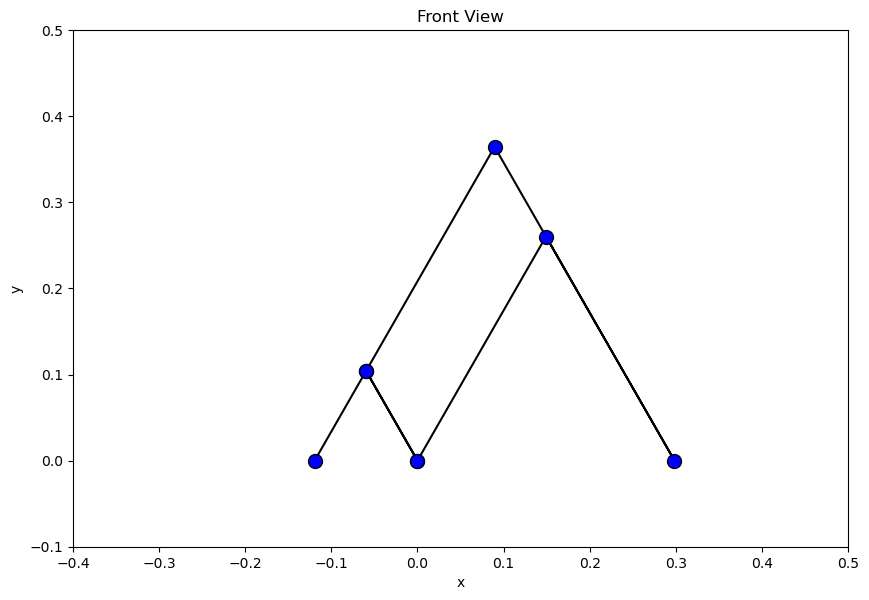

In [51]:
# Visualization

coordinates = O.pos_from(O).to_matrix(N)
for point in [P2, P1, P3, P4, O, P4, P5]:
    coordinates = coordinates.row_join(point.pos_from(O).to_matrix(N))

eval_point_coords = sm.lambdify((q, p), coordinates)
#eval_point_coords(x0[:3], p_vals)

# create a figure
fig = plt.figure()
fig.set_size_inches((10.0, 10.0))
ax_front = fig.add_subplot(1, 1, 1)

# common line and marker properties for each panel
line_prop = {
    'color': 'black',
    'marker': 'o',
    'markerfacecolor': 'blue',
    'markersize': 10,
}

# front view
x, y, z = eval_point_coords(x0[:3], p_vals)

lines_front, = ax_front.plot(x, y, **line_prop)
ax_front.set_xlim((-0.4, 0.5))
ax_front.set_ylim((-0.1, 0.5))
ax_front.set_title('Front View')
ax_front.set_xlabel('x')
ax_front.set_ylabel('y')
ax_front.set_aspect('equal')

def animate(i):
    x, y, z = eval_point_coords(xs_fsolve[i, :3], p_vals)
    lines_front.set_data(x, y)
    
ani = FuncAnimation(fig, animate, len(ts_fsolve))

HTML(ani.to_jshtml(fps=240))


In [52]:
# Forces evaluation
force_rec_x = []
force_rec_y = []

#for i in range(len(ts_fsolve)):
    #xs_fsolve[i, 3] = profile_v_front(ts_fsolve[i]) + profile_v_back(ts_fsolve[i])
    

for idx, xs_sol in tqdm(enumerate(xs_fsolve)):
    force = eval_forces(xs_sol[:3], xs_sol[3:], p_vals, np.array([force_profile(ts_fsolve[idx])]))
    force_rec_x.append(force[0])
    force_rec_y.append(force[1])
    

#xs_fsolve


2002it [06:36,  5.05it/s]


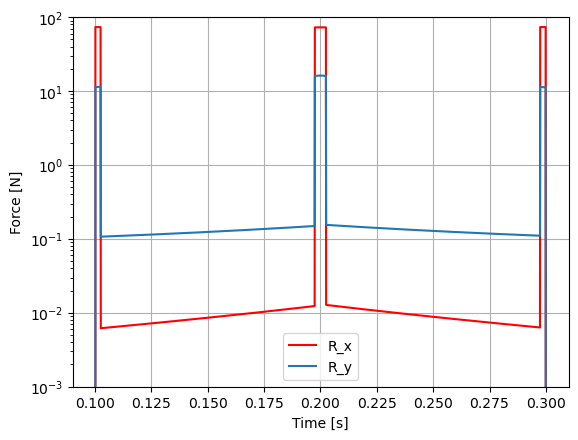

In [53]:

np_fx = np.abs(np.array([force_rec_x]))
np_fy = np.abs(np.array([force_rec_y]))


line_fx = plt.plot(ts_fsolve, np_fx.squeeze(), label='R_x', color='red')
line_fy = plt.plot(ts_fsolve, np_fy.squeeze(), label='R_y')

plt.xlabel('Time [s]')
plt.ylabel('Force [N]')

plt.ylim(0.001, 100)
plt.legend()
plt.grid()

plt.yscale('log')

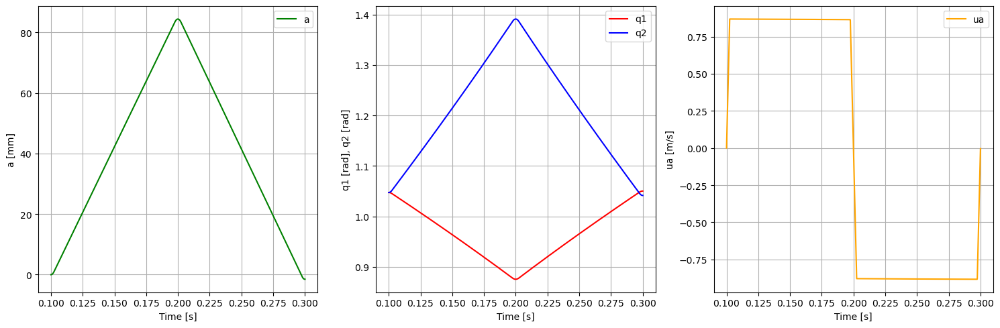

In [54]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

line_xa = ax1.plot(ts_fsolve, (xs_fsolve[:, 0]-0.3)*1000, label='a',color='green')
ax1.set_xlabel('Time [s]')
ax1.set_ylabel('a [mm]')
ax1.grid()
ax1.legend()

line_q1 = ax2.plot(ts_fsolve, xs_fsolve[:, 1], label='q1', color='red')
line_q2 = ax2.plot(ts_fsolve, xs_fsolve[:, 2]-np.pi, label='q2', color=('blue'))
ax2.set_xlabel('Time [s]')
ax2.set_ylabel('q1 [rad], q2 [rad]')
ax2.grid()
ax2.legend()

line_ua = ax3.plot(ts_fsolve, xs_fsolve[:, 3], label='ua',color='orange')
ax3.set_xlabel('Time [s]')
ax3.set_ylabel('ua [m/s]')
ax3.grid()
ax3.legend()

plt.tight_layout()
plt.show()

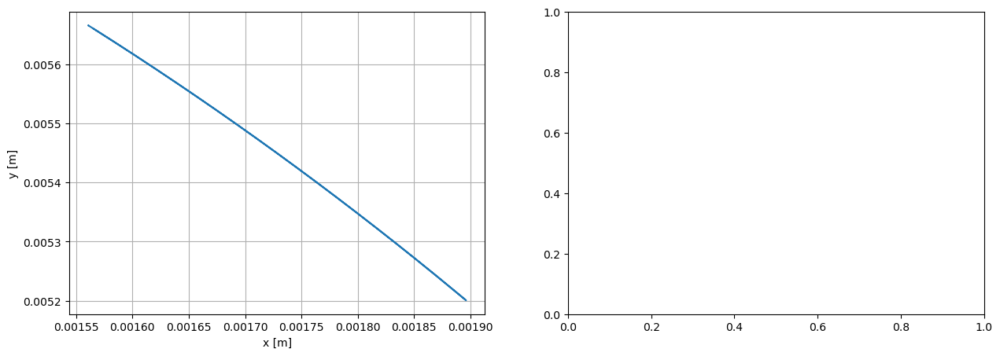

In [110]:
# Cneter of mass position estimation

eval_com = sm.lambdify((q, p), R_CM_O.to_matrix(N))

fig2, (ax_com, ax_mom) = plt.subplots(1, 2, figsize=(15, 5))


x, y, z = eval_com(x0[:3], p_vals)
lines_com, = ax_com.plot(x, y, color='blue')
com = np.empty((len(xs_fsolve), 2))
for i,xs in enumerate(xs_fsolve):
    x, y, z = eval_com(xs[:3], p_vals)
    com[i, 0]=x
    com[i, 1]=y
    
ax_com.set_xlabel('x [m]')
ax_com.set_ylabel('y [m]')
ax_com.grid()

com= com.T
ax_com.plot(com[0],com[1])
